In [1]:
import numpy as np
import cv2
from scipy import optimize
import os
%matplotlib notebook
import matplotlib.pyplot as plt

In [2]:
def get_radius_array(disk_center, nx, ny):

    x = np.arange(0, nx)
    y = np.arange(0, ny)
    xv, yv = np.meshgrid(x, y)
    radius_array = np.sqrt( (xv - disk_center[0])**2 + (yv - disk_center[1])**2 )

    return radius_array

In [3]:
def mirror_patch(im1, im2, x_center):
    im3 = im1.copy()
    im3[:, int(im3.shape[1]/2):im3.shape[1], :] = np.flip(im2[:, 0:int(im2.shape[1]/2), :], axis=1)
    return im3

In [4]:
def blend_mask_sigmoid(r1, r2, x, k):
    x0 = (r1 + r2)/2
    blend_mask1 = 1 - 1/(1+np.exp(-k*(x-x0)))
#     blend_mask1[rr <= r1] = 1
#     blend_mask1[rr >= r2] = 0
    blend_mask2 = 1 - blend_mask1
    return blend_mask1, blend_mask2

In [315]:
savedir = '/Users/rattie/Data/Eclipse/Background_removed/'
images = np.load(os.path.join(savedir, 'images_filtered.npy'))
nx = images.shape[2]
ny = images.shape[1]
center = np.array((nx/2, ny/2), dtype=np.int)
radius = 323

In [316]:
maxval = 19574
# Exposure times
nexp = 3
times_array = np.array([250, 30, 1])

In [317]:
rr = get_radius_array(center, nx, ny)
filter_r = (radius/rr)
filter_r[rr <= radius] = 1

filter_r2 = filter_r[np.newaxis, :, :, np.newaxis]
filter_r2 = np.repeat(filter_r2, 3, axis=3)
filter_r2 = np.repeat(filter_r2, 3, axis=0)
images2 = images / filter_r2

/Users/rattie/anaconda/envs/MachineLearning/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


# Attempt to blend

<IPython.core.display.Javascript object>


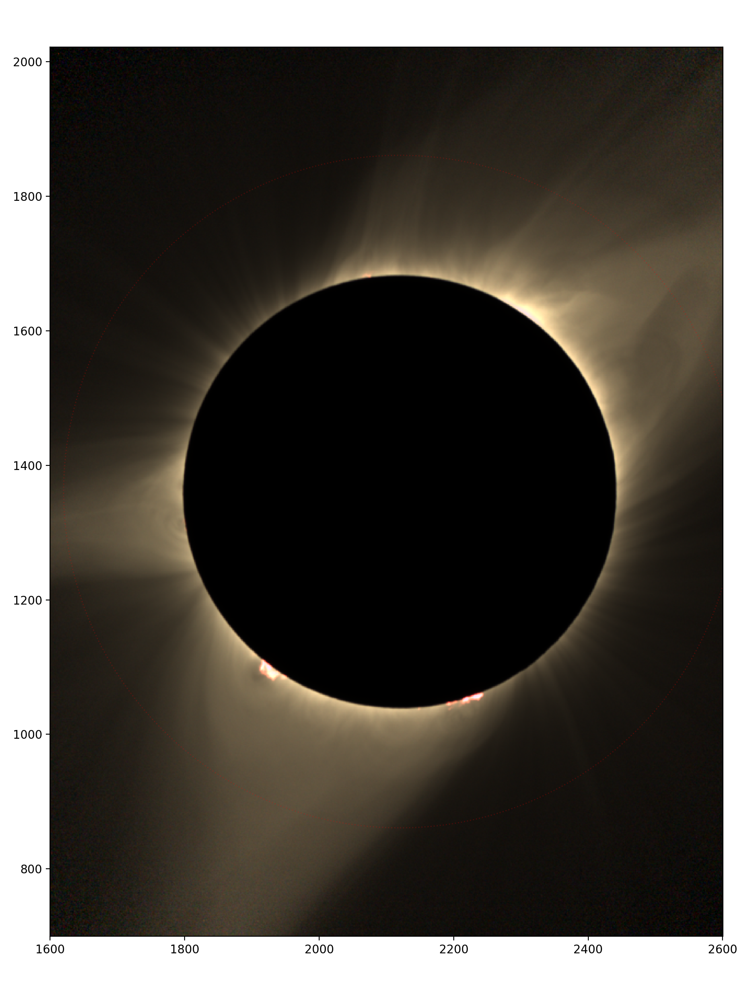

In [318]:
im250_0 = images2[0, ...]/250 * 1.1
im250_1 = images2[0, ...]/120
# Blend
r1 = 270
r2 = 500
blend_mask1, blend_mask2 = blend_mask_sigmoid(r1, r2, rr, k=0.02)
im_blended1 = im250_0 * blend_mask1[..., np.newaxis] + im250_1 * blend_mask2[..., np.newaxis]


plt.figure(figsize=(9, 12))
axis = [1600, 2600, 700, ny-700]
plt.imshow(np.clip(im_blended1, 0, 1), origin='lower')
#plt.gca().add_artist(plt.Circle(center, r1, color='g', ls=':', fill = False, alpha=0.2))
plt.gca().add_artist(plt.Circle(center, r2, color='r', ls=':', fill = False, alpha=0.2))
plt.axis(axis)
plt.tight_layout()

<IPython.core.display.Javascript object>


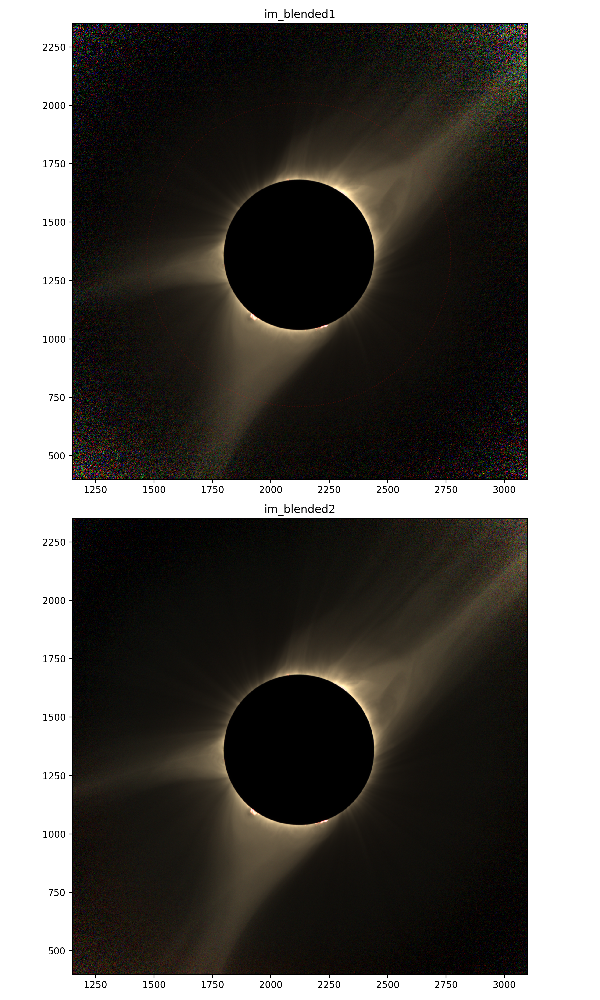

In [319]:
im30 = images2[1, ...]/120

r1 = 500
r2 = 650
blend_mask1, blend_mask2 = blend_mask_sigmoid(r1, r2, rr, k=0.02)
im_blended2 = im_blended1 * blend_mask1[..., np.newaxis] + im30 * blend_mask2[..., np.newaxis]


axis1 = [1150, 3100, 400, 2350]
plt.figure(figsize=(9, 15))
plt.subplot(2,1,1)
plt.imshow(np.clip(im_blended1, 0, 1), origin='lower')
plt.axis(axis1)
# plt.gca().add_artist(plt.Circle(center, r1, color='g', ls=':', fill = False, alpha=0.2))
plt.gca().add_artist(plt.Circle(center, r2, color='r', ls=':', fill = False, alpha=0.2))
plt.title('im_blended1')
plt.subplot(2,1,2)
plt.imshow(np.clip(im_blended2, 0, 1), origin='lower')
plt.axis(axis1)
plt.title('im_blended2')
plt.tight_layout()

<IPython.core.display.Javascript object>


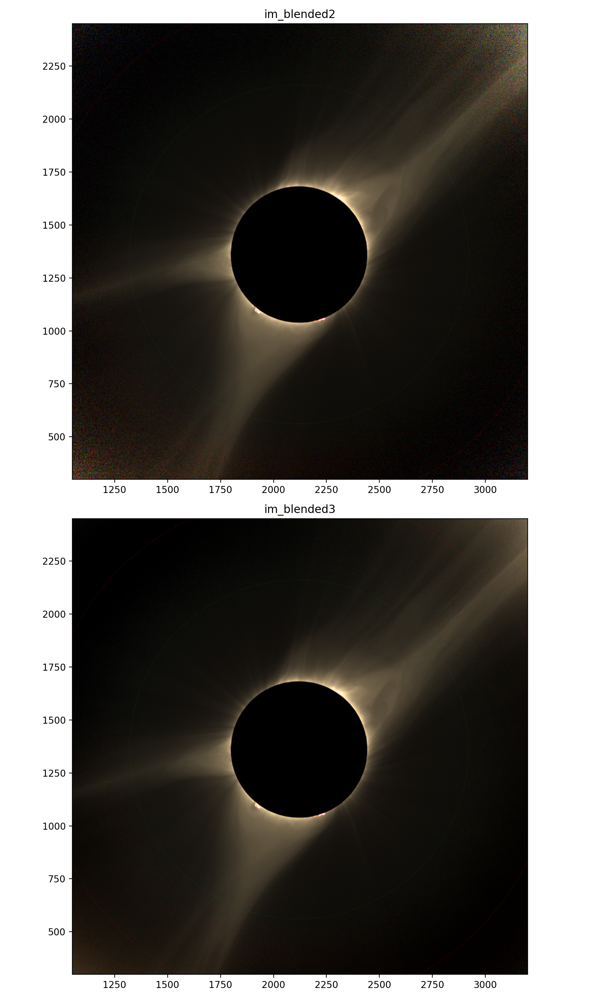

In [320]:
im1 = images2[2, ...]/160

r1 = 800
r2 = 1200
blend_mask1, blend_mask2 = blend_mask_sigmoid(r1, r2, rr, k=0.015)
im_blended3 = im_blended2 * blend_mask1[..., np.newaxis] + im1 * blend_mask2[..., np.newaxis]


axis1 = [1050, 3200, 300, 2450]
plt.figure(figsize=(9, 15))
plt.subplot(2,1,1)
plt.imshow(np.clip(im_blended2, 0, 1), origin='lower')
plt.axis(axis1)
plt.gca().add_artist(plt.Circle(center, r1, color='g', ls=':', fill = False, alpha=0.2))
plt.gca().add_artist(plt.Circle(center, r2, color='r', ls=':', fill = False, alpha=0.2))
plt.title('im_blended2')
plt.subplot(2,1,2)
plt.imshow(np.clip(im_blended3, 0, 1), origin='lower')
plt.gca().add_artist(plt.Circle(center, r1, color='g', ls=':', fill = False, alpha=0.2))
plt.gca().add_artist(plt.Circle(center, r2, color='r', ls=':', fill = False, alpha=0.2))
plt.axis(axis1)
plt.title('im_blended3')
plt.tight_layout()

In [321]:
savedir = '/Users/rattie/Data/Eclipse/Background_removed/'
image_bgr = cv2.cvtColor((np.clip(im_blended3*(2**16-1), 0, 2**16-1)).astype(np.uint16), cv2.COLOR_RGB2BGR)
fname = os.path.join(savedir, 'Blended_sigmoid_new.tiff')
cv2.imwrite(fname, image_bgr)

True

In [322]:
image_0 = cv2.cvtColor((np.clip(images[0,...]/250*(2**16-1), 0, 2**16-1)).astype(np.uint16), cv2.COLOR_RGB2BGR)
fname = os.path.join(savedir, 'background_removed_250.tiff')
cv2.imwrite(fname, image_0)

True